# Leila Ghasemzadeh - Project #2

## Advanced Lane Finding Project

The steps for this project are as follows:
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


In [1]:
import numpy as np
import cv2
import glob
%matplotlib notebook
%matplotlib inline
%pylab inline
import matplotlib as mpl
import matplotlib.pyplot as plt
# %matplotlib qt
from moviepy.editor import VideoFileClip 
from IPython.display import HTML

Populating the interactive namespace from numpy and matplotlib


# Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [2]:
# define number of internal chessboard corners in x and y direction
nx = 9
ny = 6
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)
# arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
# make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')
show = True
# step through the list and search for chessboard corners
for image in images:
    img = cv2.imread(image)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        if show:
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
            cv2.imshow('img',img)
            cv2.waitKey(500)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,
                                                      gray.shape[::-1], None, None)
cv2.destroyAllWindows()

# Apply a distortion correction to raw images.

In [3]:
# save function to write images
def save(dir, fname, img):
    fname = ''.join([dir,'undistorted_',fname])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    cv2.imwrite(fname,img)
# undistort function
def undistort_image(img):
    undistorted_img = cv2.undistort(img, mtx, dist, None, mtx)
    return undistorted_img

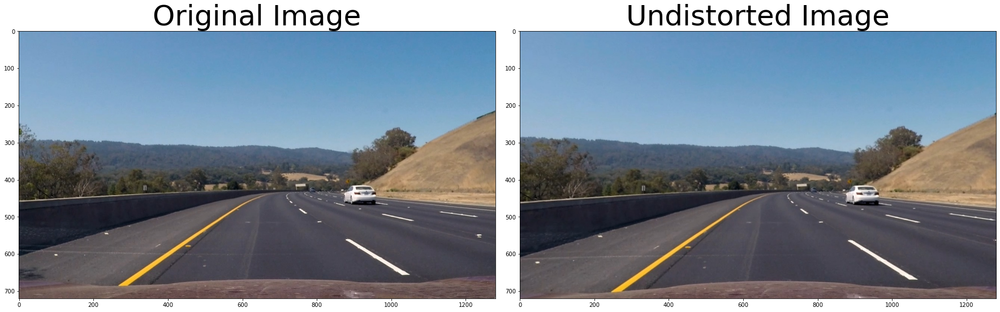

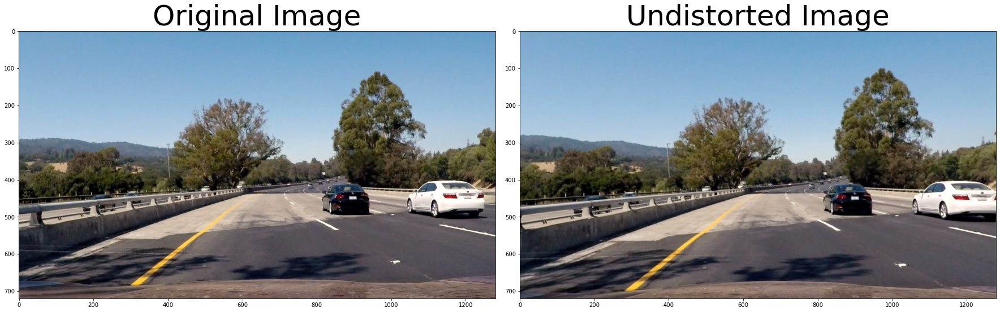

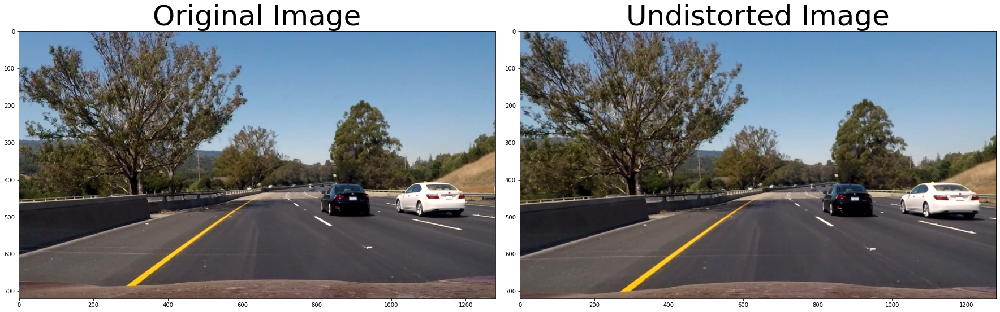

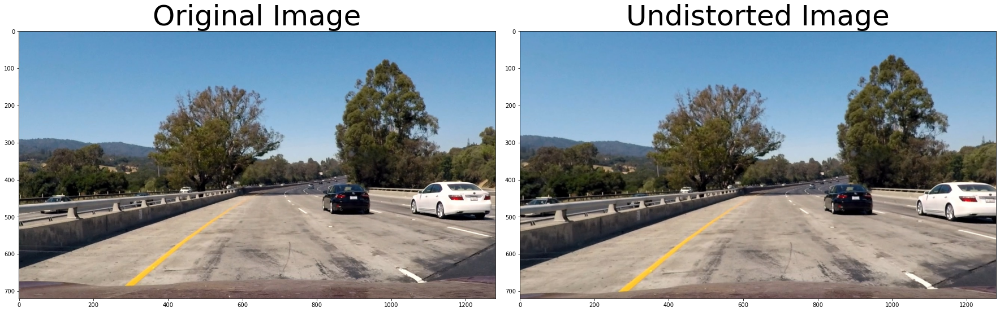

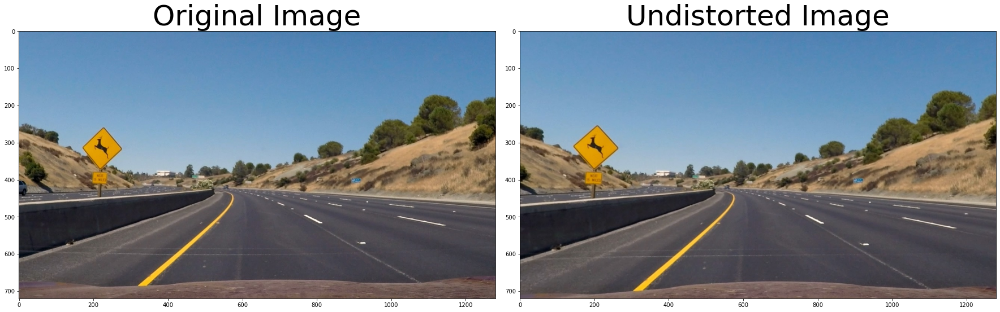

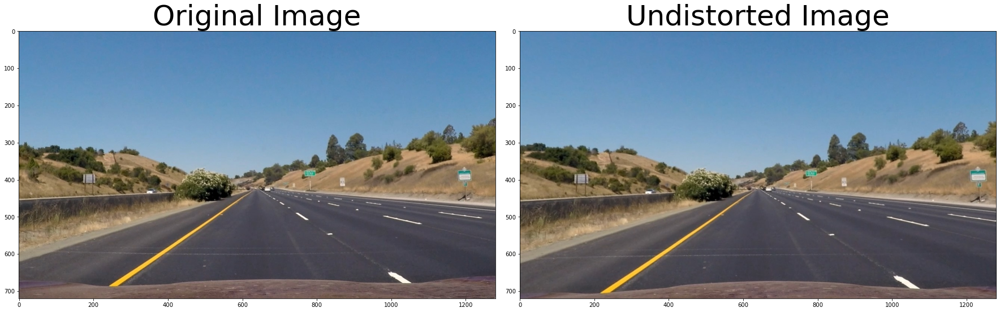

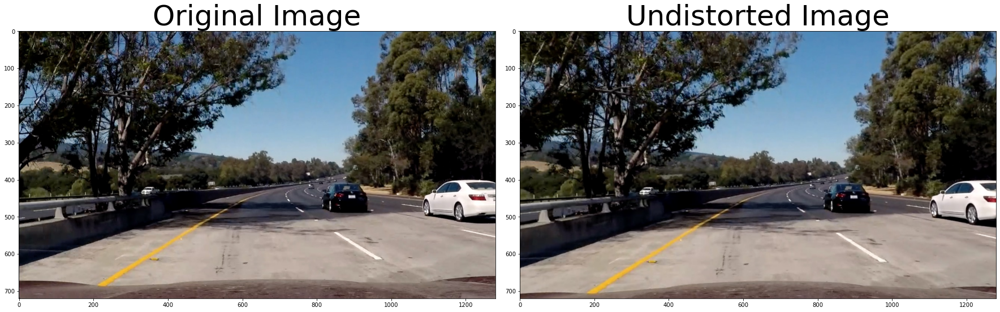

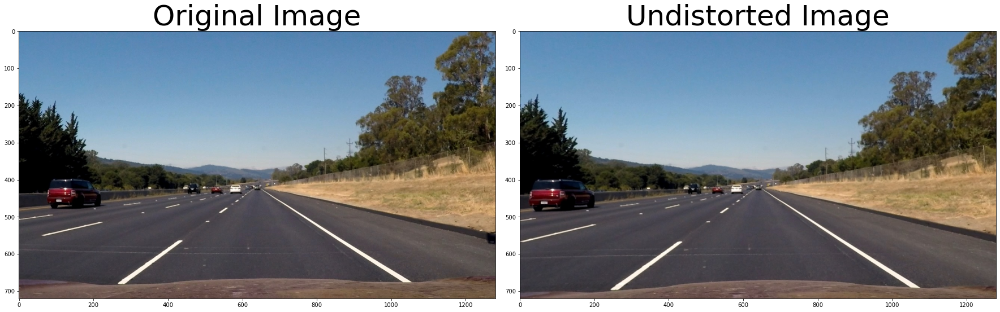

In [4]:
# apply undistort function to test images
images = glob.glob('./test_images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    # convert to RGB from BGR (since using opencv for reading images)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted = undistort_image(img)  
    #saving to a folder
    save('undistorted_images/', fname.split('/')[-1], undistorted)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    

# Use color transforms, gradients, etc., to create a thresholded binary image.

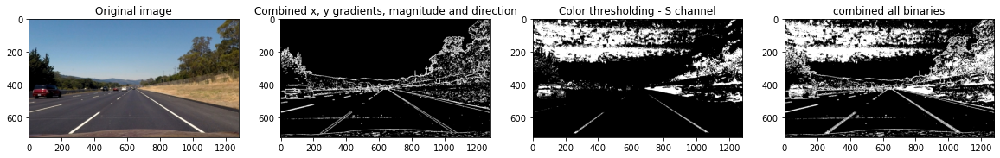

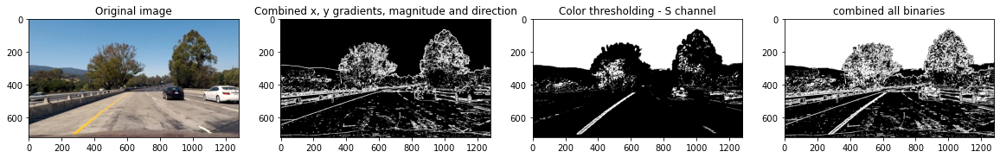

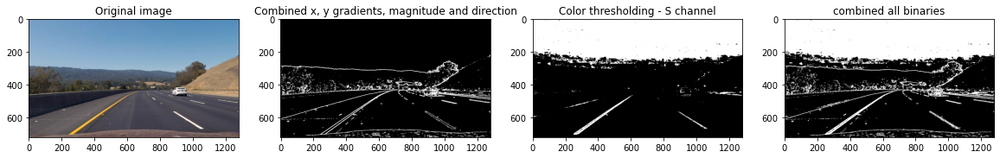

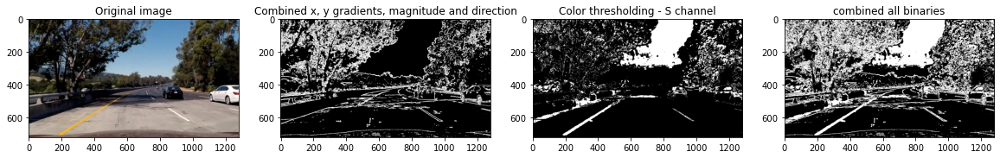

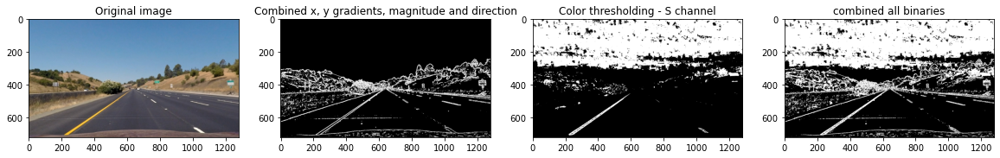

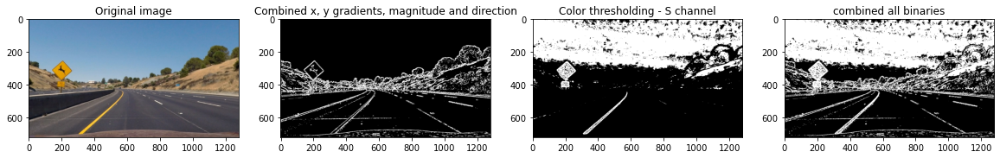

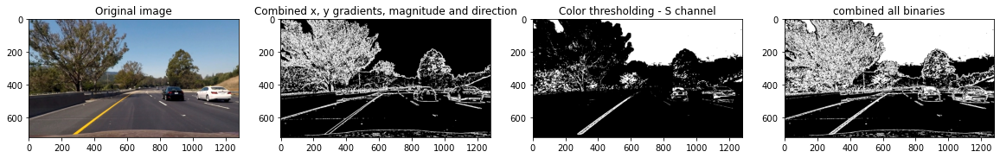

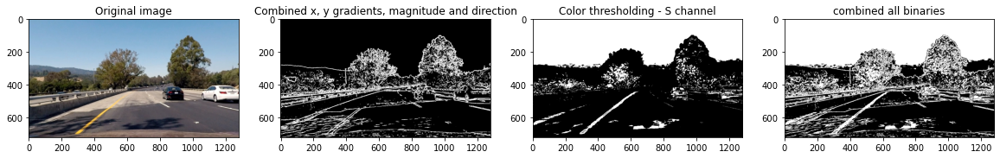

In [5]:
# Sobel x and y function with threhold and sobel kernel size
def abs_sobel_threshold(img, orient='x', sobel_kernel=5, thresh=(0, 255)):
    # convert img to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # threshold values
    thresh_min = thresh[0]
    thresh_max = thresh[1]
    
    # take derivative in x or y direction
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    else:
        print(30 * '-')
        print('The drivative direction is not entered correctly!')
        print(30 * '-')
        
    # absolute value of the derivative
    abs_sobel = np.absolute(sobel)
    # scale to 8-bit (0-255) and convert to uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # mask with ones where the scaled sobel is the range
    binary_sobel = np.zeros_like(scaled_sobel)
    binary_sobel[(scaled_sobel >= thresh_min) & (scaled_sobel < thresh_max)] = 1
    binary_grad = np.copy(binary_sobel)
    return binary_grad
        
    
# compute magnitude of gradients and apply a threshold
def mag_threshold(img, sobel_kernel=5, thresh=(0, 255)):
    # convert img to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) 
    # threshold values
    thresh_min = thresh[0]
    thresh_max = thresh[1]    
    # take the gradient in x and y separately
    sobelX = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobelY = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # calculate the magnitude 
    grad_mag = np.sqrt(sobelX**2 + sobelY**2)
    # scale to 8-bit (0 - 255) and convert to uint8
    scale_factor = np.max(grad_mag)/255
    grad_mag = (grad_mag/scale_factor).astype(np.uint8)
    # create a binary mask where mag thresholds are met
    binary_mag = np.zeros_like(grad_mag)
    binary_mag[(grad_mag >= thresh_min) & (grad_mag <= thresh_max)] = 1
    return binary_mag

# compute direction of the gradient and apply a threshold
def dir_threshold(img, sobel_kernel=5, thresh=(0, np.pi/2)):
#     convert img to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)   
    # threshold values
    thresh_min = thresh[0]
    thresh_max = thresh[1]     
    # take the gradient in x and y separately
    sobelX = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobelY = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)    
    # take the absolute value of the x and y gradients
    abs_sobelX = np.absolute(sobelX)
    abs_sobelY = np.absolute(sobelY)       
    # calculate the direction of the gradient 
    dir_grad = np.arctan2(abs_sobelY, abs_sobelX)
    # create a binary mask where direction thresholds are met
    binary_dir = np.zeros_like(dir_grad)
    binary_dir[(dir_grad >= thresh_min) & (dir_grad <= thresh_max)] = 1    
    return binary_dir

# define a generic function to transform the image to the desired colorspace
def extract_channel(img,color_space,threshold,channel=0):
    color_space = cv2.cvtColor(image, color_space)
    extracted_channel = color_space[:,:,channel]
    binary = np.zeros_like(extracted_channel)
    binary[(extracted_channel >= threshold[0]) & (extracted_channel <= threshold[1])] = 1
    return binary

def combined_sobel_grad_dir_thresh(img, ksize, show=False):
    # apply each of the thresholding functions
    Sx_binary = abs_sobel_threshold(img, orient='x', sobel_kernel=ksize, thresh=(20, 100)) 
    Sy_binary = abs_sobel_threshold(img, orient='y', sobel_kernel=ksize, thresh=(20, 100)) 
    mag_binary = mag_threshold(img, sobel_kernel=ksize, thresh=(20, 100)) 
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 25))    
    # combine all binary function outputs
    combined_binary = np.zeros_like(dir_binary)
#     combined_binary[((Sx_binary==1)&(Sy_binary==1)) | ((mag_binary==1)&(dir_binary==1))]=1
    combined_binary[(Sx_binary==1) | ((mag_binary==1)&(dir_binary==1))]=1
    
    # convert RGB to HSL
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:, :, 2]
    # thresholds for color channel
    s_thresh_min = 100 
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel>=s_thresh_min) & (s_channel<s_thresh_max)] = 1
    # combine binary matrices for S channel and combined 
    combined_s_binary = np.zeros_like(combined_binary)
    combined_s_binary[(combined_binary==1) | (s_binary==1)] = 1
    
    if show:
        p, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
        ax1.set_title('Original image')
        ax1.imshow(img)
        ax2.set_title('Combined x, y gradients, magnitude and direction')
        ax2.imshow(combined_binary, cmap='gray')
        ax3.set_title('Color thresholding - S channel')
        ax3.imshow(s_binary, cmap='gray')
        ax4.set_title('combined all binaries')
        ax4.imshow(combined_s_binary, cmap='gray')
    return combined_s_binary
    
images = glob.glob('./undistorted_images/*.jpg')
for fname in images:   
    image = cv2.imread(fname)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    combined_binary = combined_sobel_grad_dir_thresh(image, ksize=3, show=True)


# Apply a perspective transform to rectify binary image ("birds-eye view").

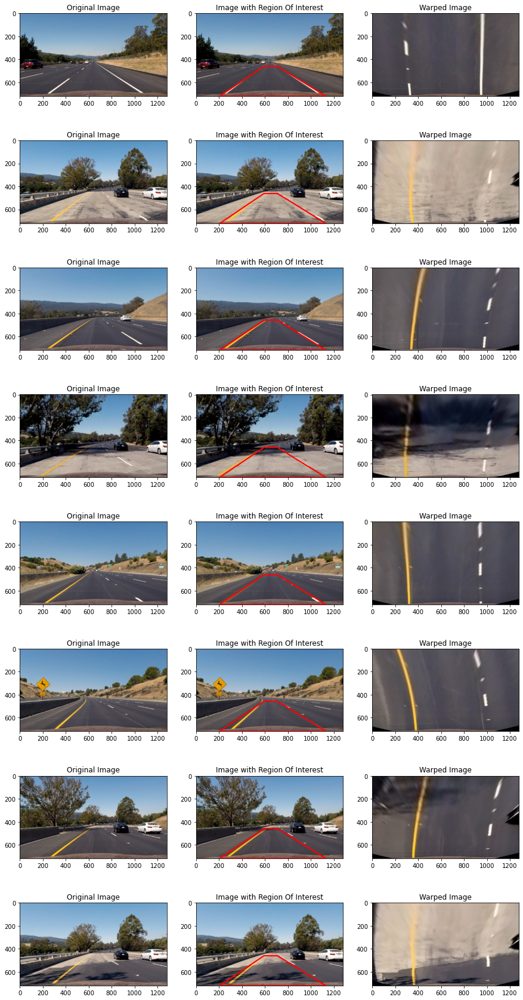

In [6]:
img_size = (img.shape[1], img.shape[0])
# reference points for perspective transform
lu_point = [589, 460]
ru_point = [705, 460]
ll_point = [203, 720]
rl_point = [1127, 720]
# define source and destination 
src = np.float32([lu_point, ll_point, ru_point, rl_point])
dst = np.float32([[320, 0], [320, 720], [960, 0], [960, 720]])

def ROI(img):
    return cv2.polylines(img,np.int32(np.array([[ll_point,lu_point,ru_point,rl_point]])),True,(255,0,0),10)

def WarpPerspective(img):
    y=img.shape[0]
    x=img.shape[1]
    M = cv2.getPerspectiveTransform(src, dst)
    return cv2.warpPerspective(img, M, (x,y), flags=cv2.INTER_LINEAR)

# testing the warped images in ROI
f, axes= plt.subplots(8,3,figsize=(15,30))
f.subplots_adjust(hspace=0.5)

warped_images=[]
for index, image in enumerate(images):
    original_image= cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB)
    no_change_image= original_image.copy()
    axes[index,0].imshow(original_image)
    axes[index,0].set_title("Original Image")
    ROI(original_image)
    axes[index,1].imshow(original_image)
    axes[index,1].set_title("Image with Region Of Interest")
    y=no_change_image.shape[0]
    x=no_change_image.shape[1]
    warped = WarpPerspective(no_change_image)
    warped_images.append(warped)
    axes[index,2].imshow(warped)
    axes[index,2].set_title("Warped Image")

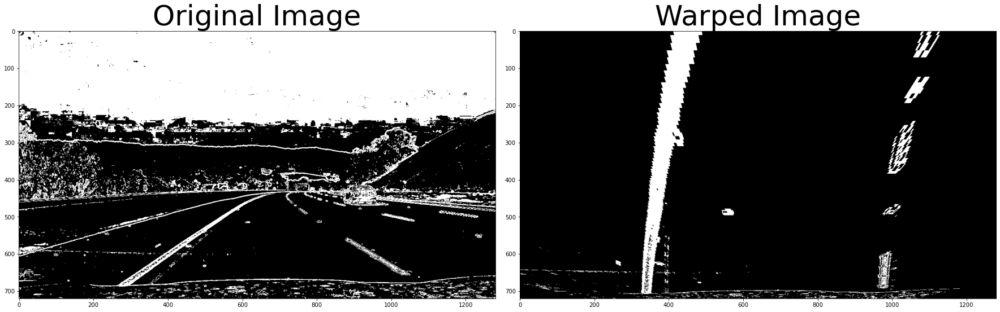

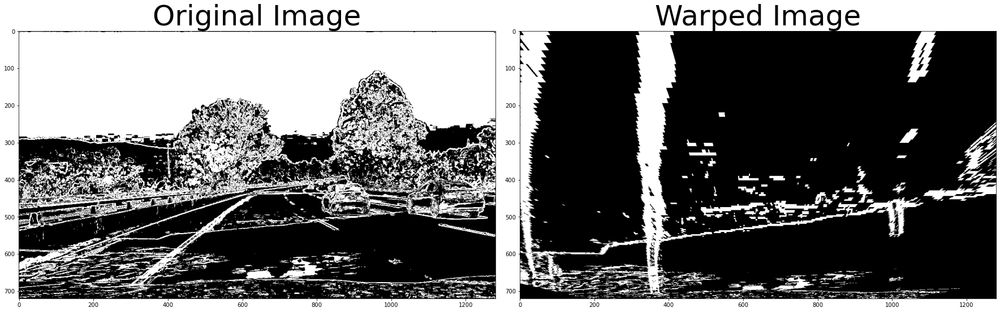

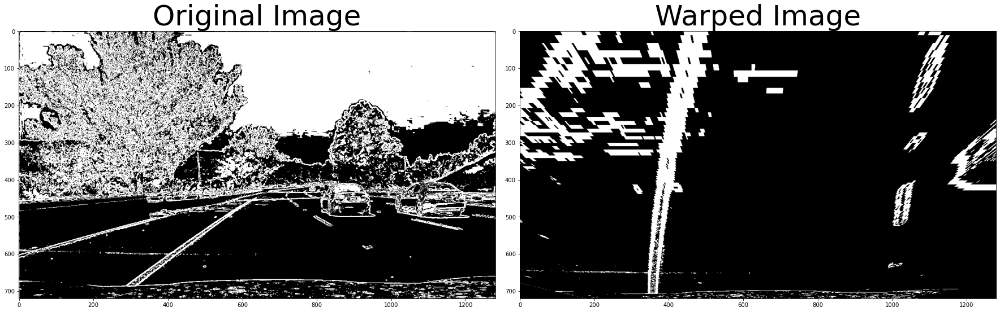

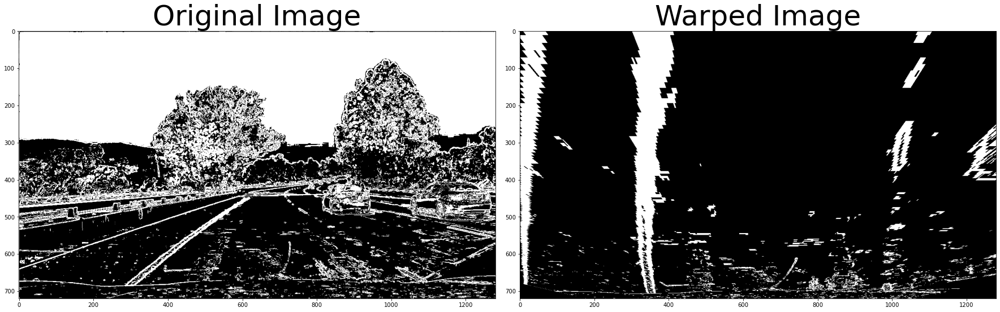

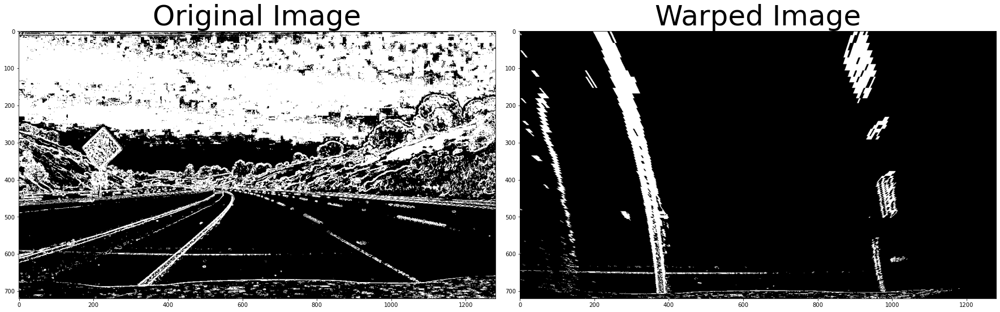

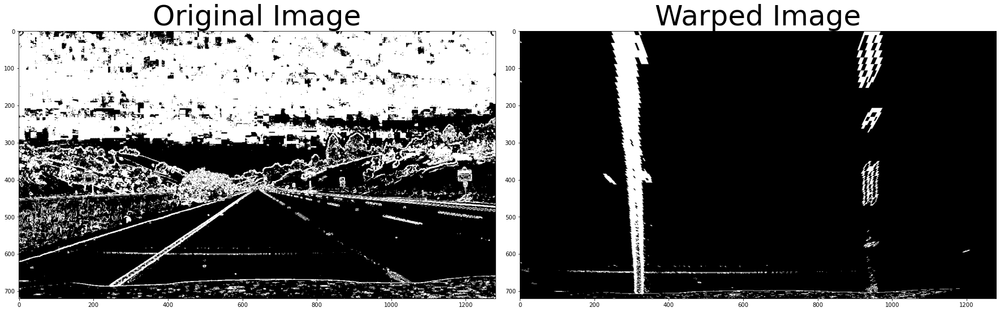

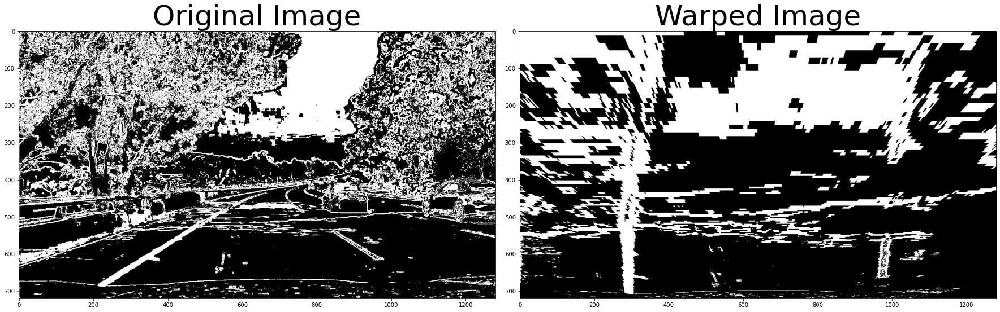

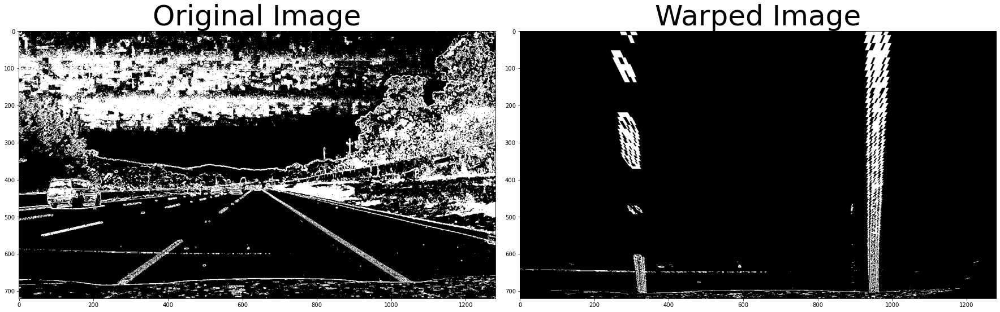

In [7]:
def perspective_trnsform(img, nx, ny):
    # define an offset for dst points
#     offset = 300
    img_size = (img.shape[1], img.shape[0])
    # calculate perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image
    warped_img = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)    
    return warped_img, M

def visualize_transorm_image(combined_binary, warped_img):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(combined_binary, cmap='gray')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped_img,cmap='gray')
    ax2.set_title('Warped Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

images = glob.glob('./test_images/*.jpg')
for fname in images:   
    image = cv2.imread(fname)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    combined_binary = combined_sobel_grad_dir_thresh(image, ksize=3, show=False)
    warped_img, M = perspective_trnsform(combined_binary, nx=9, ny=6) 
    visualize_transorm_image(combined_binary, warped_img)
    

# Detect lane pixels and fit to find the lane boundary.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


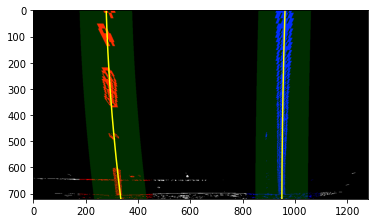

In [8]:
# histogram function
def hist(img):
    # get bottom half of the image
    bottom_half = img[img.shape[0]//2:, :]
    # take histogram along the columns
    histogram = np.sum(bottom_half, axis=0)
    return histogram

# locate lane lines and window fitting having histogram of line points
def locate_lines(warped_binary, nwindows=9, margin=140, minpix=50): # margin=100
    # take the histogram of candidate points for detecting lane line
    histogram = hist(warped_binary)
    # find the peak of the left and right lines on histogram
    midpoint = np.int(histogram.shape[0]//2)
    leftX_base = np.argmax(histogram[:midpoint])
    rightX_base = np.argmax(histogram[midpoint:]) + midpoint
    # set the height of the windows
    window_height = np.int(warped_binary.shape[0]//nwindows)
    # spot the x and y direction of all activated pixels in the image
    nonzero = warped_binary.nonzero()
    nonzeroX = np.array(nonzero[1])
    nonzeroY = np.array(nonzero[0])
    # Current positions to be updated later for each window in nwindows
    leftX_current = leftX_base
    rightX_current = rightX_base 
    # create a list to record left and right pixel indices
    left_lane_idx = []
    right_lane_idx = []
    # Create an image to draw on 
    output_img = np.dstack((warped_binary, warped_binary, warped_binary))*255    
    for window in range(nwindows):
        # identify window boundaries in x and y 
        winY_low = warped_binary.shape[0] - (window+1)*window_height
        winY_high = warped_binary.shape[0] - window*window_height
        winXleft_low = leftX_current - margin
        winXleft_high = leftX_current + margin
        winXright_low = rightX_current - margin
        winXright_high = rightX_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(output_img, (winXleft_low, winY_low), (winXleft_high, winY_high),
        (0,255,0), 2) 
        cv2.rectangle(output_img, (winXright_low, winY_low), (winXright_high, winY_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroY >= winY_low) & (nonzeroY < winY_high) & 
        (nonzeroX >= winXleft_low) &  (nonzeroX < winXleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroY >= winY_low) & (nonzeroY < winY_high) & 
        (nonzeroX >= winXright_low) &  (nonzeroX < winXright_high)).nonzero()[0]
        # append these indices to the lists
        left_lane_idx.append(good_left_inds)
        right_lane_idx.append(good_right_inds)
        # if found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftX_current = np.int(np.mean(nonzeroX[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightX_current = np.int(np.mean(nonzeroX[good_right_inds]))    
            
    # Concatenate the arrays of indices
    left_lane_idx = np.concatenate(left_lane_idx)
    right_lane_idx = np.concatenate(right_lane_idx)    
    # Extract left and right line pixel positions
    leftX = nonzeroX[left_lane_idx]
    leftY = nonzeroY[left_lane_idx] 
    rightX = nonzeroX[right_lane_idx]
    rightY = nonzeroY[right_lane_idx]     
    # Fit a second order polynomial to each
    if len(leftX) == 0:
        left_fit =[]
    else:
        left_fit = np.polyfit(leftY, leftX, 2)
    
    if len(rightX) == 0:
        right_fit =[]
    else:
        right_fit = np.polyfit(rightY, rightX, 2)
        
    return left_fit, right_fit, left_lane_idx, right_lane_idx, nonzeroX, nonzeroY   
    
def locate_line_further(left_fit, right_fit, binary_warped):    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) 
                      & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) 
                       & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    if len(leftx) == 0:
        left_fit_new =[]
    else:
        left_fit_new = np.polyfit(lefty, leftx, 2)
    
    if len(rightx) == 0:
        right_fit_new =[]
    else:
        right_fit_new = np.polyfit(righty, rightx, 2)
     
    return left_fit_new, right_fit_new

def visulizeLanes(left_fit, right_fit, left_lane_inds, right_lane_inds, binary_warped, nonzerox, nonzeroy, margin = 100):
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,0.6, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,0.6, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    
    
left_fit, right_fit,left_lane_inds, right_lane_inds, nonzerox, nonzeroy = locate_lines(warped_img) 
visulizeLanes(left_fit, right_fit, left_lane_inds, right_lane_inds, warped_img, nonzerox, nonzeroy, margin = 100)    

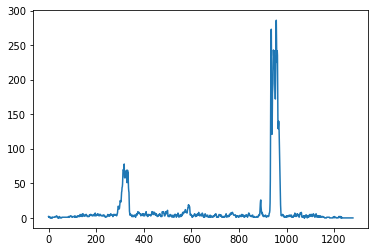

In [9]:
hh = plt.plot(hist(warped_img))


# Determine the curvature of the lane and vehicle position with respect to center.

In [10]:
def radius_curvature(warped_binary, left_fit, right_fit):
    
    ploty = np.linspace(0, warped_binary.shape[0]-1, warped_binary.shape[0] )
    # conversion from pixel to meter
    ym_per_pix = 30/720 # meters per pixel in y-dimension
    xm_per_pix = 3.7/700 # meters per pixel in x-dimension
    y_eval = np.max(ploty)
    
    # fit new polynomials in world model
    left_curvature =  ((1 + (2*left_fit[0]*y_eval*ym_per_pix + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curvature = ((1 + (2*right_fit[0]*y_eval*ym_per_pix + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
       
    # calculate vehicle center
    center = (((left_fit[0]*720**2+left_fit[1]*720+left_fit[2]) 
               +(right_fit[0]*720**2+right_fit[1]*720+right_fit[2]) )
               /2 - 640)*xm_per_pix
    position = "left" if center < 0 else "right"
    center = "{:.2f} m {}".format(center, position)
    
    # Now our radius of curvature is in meters
    return left_curvature, right_curvature, center

left_curvature, right_curvature, center = radius_curvature(warped_img, left_fit, right_fit)

# Warp the detected lane boundaries back onto the original image.
# Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


In [11]:
def draw_on_image(undist, warped_img, left_fit, right_fit, M, left_curvature, right_curvature, center, show_values = False):
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    Minv = np.linalg.inv(M)
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
#     cv2.putText(result, 'Left curvature: {:.0f} m'.format(left_curvature), (50, 250), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
#     cv2.putText(result, 'Right curvature: {:.0f} m'.format(right_curvature), (50, 300), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
#     cv2.putText(result, '{}'.format(center), (50, 350), cv2.FONT_HERSHEY_DUPLEX, 1, (255, 255, 255), 2)
    if show_values == True:
        fig, ax = plt.subplots(figsize=(20, 10))
        ax.imshow(result)
        
    return result

array([[[173, 190, 208],
        [134, 155, 176],
        [118, 144, 171],
        ...,
        [ 45,  51,  51],
        [ 27,  31,  34],
        [ 36,  40,  43]],

       [[132, 153, 174],
        [121, 143, 167],
        [ 99, 129, 157],
        ...,
        [ 73,  79,  79],
        [ 59,  63,  66],
        [ 30,  34,  37]],

       [[117, 143, 170],
        [101, 131, 159],
        [ 91, 126, 158],
        ...,
        [ 72,  76,  77],
        [ 78,  82,  85],
        [ 49,  53,  56]],

       ...,

       [[127, 113, 112],
        [107,  93,  92],
        [ 99,  84,  81],
        ...,
        [ 97,  81,  65],
        [109,  93,  77],
        [133, 117, 101]],

       [[145, 134, 132],
        [119, 108, 106],
        [ 99,  85,  84],
        ...,
        [ 98,  82,  67],
        [123, 107,  92],
        [150, 137, 121]],

       [[191, 180, 178],
        [147, 136, 134],
        [127, 113, 112],
        ...,
        [131, 115, 100],
        [148, 134, 121],
        [194, 180, 167]]

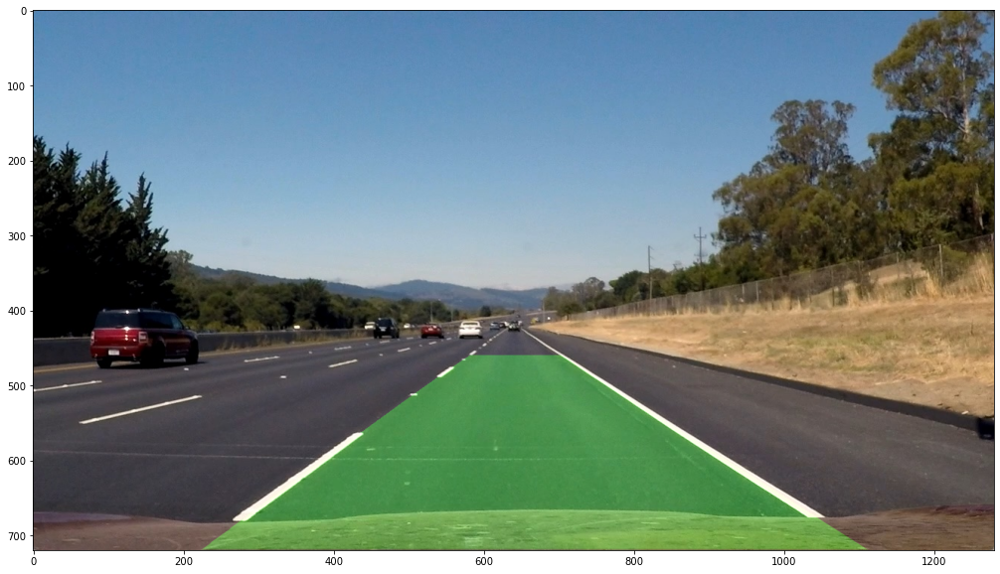

In [12]:
# img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
draw_on_image(img, warped_img, left_fit, right_fit, M, left_curvature, right_curvature, center, True)

In [13]:

def sanity_check(left_fit, right_fit, minSlope, maxSlope):
    #Performs a sanity check on the lanes
    #Check 1: check if left and right fits exists
    #Check 2: Calculates the tangent between left and right in two points, and check if it is in a reasonable threshold
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    if len(left_fit) ==0 or len(right_fit) == 0:
        status = False
        d0=0
        d1=0
        #Previous fitlines routine returns empty list to them if not finds
    else:
        #Difference of slope
        L_0 = 2*left_fit[0]*460+left_fit[1]
        R_0 = 2*right_fit[0]*460+right_fit[1]
        d0 =  np.abs(L_0-R_0)

        L_1 = 2*left_fit[0]*720+left_fit[1]
        R_1 = 2*right_fit[0]*720+right_fit[1]
        d1 =  np.abs(L_1-R_1)

        
        if d0>= minSlope and d0<= maxSlope and d1>= minSlope and d1<= maxSlope:
            status = True
        else:
            status = False
            
    return(status, d0, d1)

In [14]:
#Function to process the image
global counter
counter=0
ref_left =np.array([-0.0001,0,400])
ref_right=np.array([-0.0001,0,1000])   
left_fit =np.array([-0.0001,0,400])
right_fit=np.array([-0.0001,0,1000])

def pipeline(img):
    undistorted_image= undistort_image(img)
    global counter
    global ref_left 
    global ref_right
    global left_fit
    global right_fit
    warped_image, M= perspective_trnsform(undistorted_image, nx=9, ny=6)
    combined_image = combined_sobel_grad_dir_thresh(warped_image, ksize=3, show=False)
    combined_image_full = combined_sobel_grad_dir_thresh(undistorted_image, ksize=3, show=False)
    if counter == 0:
        left_fit, right_fit, left_lane_idx, right_lane_idx, nonzeroX, nonzeroY = locate_lines(combined_image, nwindows=9, margin=100, minpix=50)
    else:
        left_fit, right_fit = locate_line_further(left_fit, right_fit, combined_image)
        
    status_sanity, d0, d1 =sanity_check(left_fit, right_fit, 0, 2.55)
    
    #Calc curvature and center
    if status_sanity  == True:        
        #Save as last reliable fit
        ref_left, ref_right = left_fit, right_fit        
        counter+=1
    else:        #Use the last realible fit
        left_fit, right_fit = ref_left, ref_right
        
    left_curvature, right_curvature, center = radius_curvature(combined_image, left_fit, right_fit)
    result=draw_on_image(undistorted_image, combined_image, left_fit, right_fit, M, left_curvature, right_curvature, center, show_values = False)
    
    #Composition of images to final display
    img_out=np.zeros((576,1280,3), dtype=np.uint8)

    img_out[0:576,0:1024,:] =cv2.resize(result,(1024,576))
    #b) Threshold
    img_out[0:288,1024:1280, 0] =cv2.resize(combined_image_full*255,(256,288))
    img_out[0:288,1024:1280, 1] =cv2.resize(combined_image_full*255,(256,288))
    img_out[0:288,1024:1280, 2] =cv2.resize(combined_image_full*255,(256,288))
    #c)Birds eye view
    img_out[310:576,1024:1280,:] =cv2.resize(warped_image,(256,266))
    
    #Write curvature and center in image
    TextL = "Left curvature: " + str(int(left_curvature)) + " m"
    TextR = "Right curvature: " + str(int(right_curvature))+ " m"
    TextC = "Center offset: " + str(center)
    fontScale=1
    thickness=2
    
    fontFace = cv2.cv2.FONT_HERSHEY_DUPLEX


    cv2.putText(img_out, TextL, (50, 50), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(img_out, TextR, (50,90), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(img_out, TextC, (50,130), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    return img_out

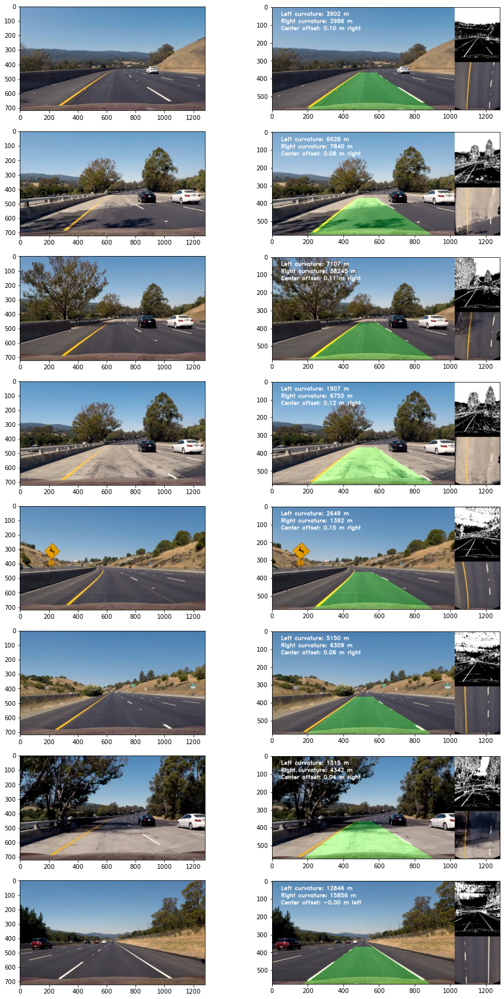

In [15]:
f, axes= plt.subplots(8,2,figsize=(15,30))
images = glob.glob('./test_images/*.jpg') # Reading Images from test_images folder
for index, image in enumerate(images):
#     originalImage= cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB)
#     img = cv2.imread(image)
    img = cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB)
    final_image=pipeline(img)
    cv2.imwrite('output_images/'+str(index)+'.jpg', cv2.cvtColor(final_image,cv2.COLOR_BGR2RGB))
    axes[index,0].imshow(img)
    axes[index,1].imshow(final_image)

In [16]:
video_output1 = 'project_video_output.mp4'
video_input1 = VideoFileClip('project_video.mp4')
processed_video = video_input1.fl_image(pipeline)
%time processed_video.write_videofile(video_output1, audio=False)

t:   0%|          | 2/1260 [00:00<01:49, 11.47it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
CPU times: user 32min 7s, sys: 2min 11s, total: 34min 19s
Wall time: 3min 25s
